## YOLO 8s
Dataset 501
train3

In [2]:
from ultralytics import YOLO

model_path = "/home/jovyan/__ANIMALS/datasets/ds1/runs/detect/train3/weights/best.pt"
model = YOLO(model_path)

data_yaml = "/home/jovyan/__ANIMALS/datasets/ds1/animals.yaml"
    
    # Run validation
results = model.val(
        data=data_yaml,
        split='val',
        save_json=True,
        save_conf=True,
        save_txt=True
)
    

Ultralytics 8.3.104 🚀 Python-3.12.7 torch-2.6.0+cu124 CPU (Intel Xeon Processor (Icelake))
Model summary (fused): 72 layers, 11,133,324 parameters, 0 gradients, 28.5 GFLOPs


val: Scanning /home/jovyan/__ANIMALS/datasets/ds1/val/labels.cache... 105 images, 0 backgrounds, 0 corrupt: 100%|██████████| 105/105 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.52s/it]


                   all        105        113      0.604      0.749      0.714      0.465
                badger          5          5      0.511        0.4       0.54      0.244
                  boar          5          5      0.653          1      0.962      0.692
                  lynx          2          2      0.367        0.5      0.638      0.574
             musk_deer          1          1          1          0          0          0
               red_fox          2          2       0.43          1      0.828      0.598
       roe_deer_female         12         15      0.543      0.867      0.614      0.454
         roe_deer_male          6          6      0.455        0.5      0.608      0.518
                 sable          1          1      0.818          1      0.995      0.207
      sika_deer_female          8         10       0.47        0.7      0.616      0.441
        sika_deer_male          7          7      0.744      0.831      0.933      0.554
                 tige

In [9]:
results.confusion_matrix.print

<bound method ConfusionMatrix.print of <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f89da9e7650>>

## YOLO 8n
Dataset 501

train2

In [1]:
from ultralytics import YOLO

model_path = "/home/jovyan/__ANIMALS/datasets/ds1/runs/detect/train2/weights/best.pt"
model = YOLO(model_path)

data_yaml = "/home/jovyan/__ANIMALS/datasets/ds1/animals.yaml"
    
    # Run validation
results = model.val(
        data=data_yaml,
        split='val',
        save_json=True,
        save_conf=True,
        save_txt=True
)
    

Ultralytics 8.3.104 🚀 Python-3.12.7 torch-2.6.0+cu124 CPU (Intel Xeon Processor (Icelake))
Model summary (fused): 72 layers, 3,009,548 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /home/jovyan/__ANIMALS/datasets/ds1/val/labels.cache... 105 images, 0 backgrounds, 0 corrupt: 100%|██████████| 105/105 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:14<00:00,  2.04s/it]


                   all        105        113      0.621      0.716      0.739      0.489
                badger          5          5      0.699      0.478      0.831      0.426
                  boar          5          5       0.57          1       0.88      0.536
                  lynx          2          2      0.558        0.5      0.828      0.713
             musk_deer          1          1          1          0          0          0
               red_fox          2          2      0.428          1      0.995      0.748
       roe_deer_female         12         15      0.731      0.867      0.734      0.467
         roe_deer_male          6          6      0.256      0.333      0.403      0.356
                 sable          1          1      0.355       0.71      0.497     0.0498
      sika_deer_female          8         10      0.433        0.6      0.638      0.443
        sika_deer_male          7          7      0.508      0.714      0.771      0.586
                 tige

In [5]:
import os
import json
import shutil
from sklearn.model_selection import train_test_split

# Paths
json_file = "result.json"
images_dir = "/home/jovyan/__ANIMALS/images"
train_dir = "train"
val_dir = "val"

# Create train and validation directories
os.makedirs(os.path.join(train_dir, "images"), exist_ok=True)
os.makedirs(os.path.join(train_dir, "labels"), exist_ok=True)
os.makedirs(os.path.join(val_dir, "images"), exist_ok=True)
os.makedirs(os.path.join(val_dir, "labels"), exist_ok=True)

# Load JSON file
with open(json_file, "r") as f:
    coco_data = json.load(f)

# Extract image and annotation data
images = {img["id"]: img["file_name"].split("/")[-1] for img in coco_data["images"]}
annotations = coco_data["annotations"]
categories = {cat["id"]: cat["name"] for cat in coco_data["categories"]}

# Group image IDs by category
category_to_image_ids = {name: set() for name in categories.values()}

for annotation in annotations:
    image_id = annotation["image_id"]
    category_id = annotation["category_id"]
    category_name = categories[category_id]
    
    # Add the image ID to the corresponding category
    category_to_image_ids[category_name].add(image_id)

# Convert sets to lists for splitting
category_to_image_ids = {k: list(v) for k, v in category_to_image_ids.items()}

# Split each category into train (80%) and validation (20%)
train_image_ids = []
val_image_ids = []

for category, image_ids in category_to_image_ids.items():
    if len(image_ids) > 1:
        train, val = train_test_split(image_ids, test_size=0.2, random_state=42)
    else:
        train, val = image_ids, []  # Assign all images to train if there's only one

    train_image_ids.extend(train)
    val_image_ids.extend(val)

# Remove duplicates (in case an image belongs to multiple categories)
train_image_ids = list(set(train_image_ids))
val_image_ids = list(set(val_image_ids))

print(f"Total train images: {len(train_image_ids)}, Total validation images: {len(val_image_ids)}")

# Copy images to train and validation directories
for img_id in train_image_ids:
    img_name = images[img_id].split("__")[-1]
    src = os.path.join(images_dir, img_name)
    dst = os.path.join(train_dir, "images", img_name)
    if os.path.exists(src):
        shutil.copyfile(src, dst)
    else:
        print(f"Warning: Train image {img_name} not found.")

for img_id in val_image_ids:
    img_name = images[img_id].split("__")[-1]
    src = os.path.join(images_dir, img_name)
    dst = os.path.join(val_dir, "images", img_name)
    if os.path.exists(src):
        shutil.copyfile(src, dst)
    else:
        print(f"Warning: Validation image {img_name} not found.")

print("Dataset split and organization completed successfully.")

Total train images: 398, Total validation images: 105
Dataset split and organization completed successfully.


In [6]:
# Get all image IDs from the images section
all_image_ids = set(images.keys())

# Get all image IDs from the annotations section
annotated_image_ids = set(ann["image_id"] for ann in annotations)

# Find unannotated images
unannotated_image_ids = all_image_ids - annotated_image_ids

print(f"Total images in JSON: {len(all_image_ids)}")
print(f"Annotated images: {len(annotated_image_ids)}")
print(f"Unannotated images: {len(unannotated_image_ids)}")

Total images in JSON: 501
Annotated images: 501
Unannotated images: 0


### Clear all directories

In [4]:
import os
import shutil

# Paths to the directories
train_images_dir = "train/images"
train_labels_dir = "train/labels"
val_images_dir = "val/images"
val_labels_dir = "val/labels"

# Function to remove all files and directories within a given directory
def clear_directory(directory):
    try:
        # Remove all files and subdirectories within the specified directory
        for root, dirs, files in os.walk(directory, topdown=False):
            for name in files:
                os.remove(os.path.join(root, name))
            for name in dirs:
                os.rmdir(os.path.join(root, name))
        print(f"All files and subdirectories removed from {directory}.")
    except Exception as e:
        print(f"Error removing files from {directory}: {e}")

# Clear the train images directory
clear_directory(train_images_dir)

# Clear the train labels directory
clear_directory(train_labels_dir)

# Clear the validation images directory
clear_directory(val_images_dir)

# Clear the validation labels directory
clear_directory(val_labels_dir)

print("All directories have been cleared successfully.")

All files and subdirectories removed from train/images.
All files and subdirectories removed from train/labels.
All files and subdirectories removed from val/images.
All files and subdirectories removed from val/labels.
All directories have been cleared successfully.


### Load JSON File and Extract Data
First, we'll load the JSON file and extract the necessary data: images, annotations, and categories.

In [1]:
import json
import os
import shutil
from sklearn.model_selection import train_test_split

# Paths
json_file = "result.json"
images_dir = "/home/jovyan/__ANIMALS/images"
train_dir = "train"
val_dir = "val"

# Create train and validation directories
os.makedirs(os.path.join(train_dir, "images"), exist_ok=True)
os.makedirs(os.path.join(train_dir, "labels"), exist_ok=True)
os.makedirs(os.path.join(val_dir, "images"), exist_ok=True)
os.makedirs(os.path.join(val_dir, "labels"), exist_ok=True)

# Load JSON file
with open(json_file, "r") as f:
    coco_data = json.load(f)

# Extract image and annotation data
images = {img["id"]: img["file_name"].split("/")[-1] for img in coco_data["images"]}
annotations = coco_data["annotations"]
categories = {cat["id"]: cat["name"] for cat in coco_data["categories"]}

# Filter images to include only those with annotations
annotated_images = set(ann["image_id"] for ann in annotations)
filtered_images = {img_id: images[img_id] for img_id in images if img_id in annotated_images}

# Group images by category
category_to_image_ids = {name: set() for name in categories.values()}

for annotation in annotations:
    image_id = annotation["image_id"]
    category_id = annotation["category_id"]
    category_name = categories[category_id]
    
    # Add the image ID to the corresponding category
    category_to_image_ids[category_name].add(image_id)

# Convert sets to lists for splitting
category_to_image_ids = {k: list(v) for k, v in category_to_image_ids.items()}

### Split Images into Train and Validation Sets
Next, we'll split the images into training and validation sets while maintaining class balance.

In [2]:
# Split each category into train (80%) and validation (20%)
train_image_ids = []
val_image_ids = []

for category, image_ids in category_to_image_ids.items():
    if len(image_ids) > 1:
        train, val = train_test_split(image_ids, test_size=0.2, random_state=42)
    else:
        train, val = image_ids, []  # Assign all images to train if there's only one

    train_image_ids.extend(train)
    val_image_ids.extend(val)

# Remove duplicates (in case an image belongs to multiple categories)
train_image_ids = list(set(train_image_ids))
val_image_ids = list(set(val_image_ids))

print(f"Total train images: {len(train_image_ids)}, Total validation images: {len(val_image_ids)}")

Total train images: 398, Total validation images: 105


### Copy Images to Train and Validation Folders
Now, we'll copy the images to their respective train and validation folders.

In [3]:
# Copy images to train and validation directories
for img_id in train_image_ids:
    img_name = images[img_id].split("__")[-1]
    src = os.path.join(images_dir, img_name)
    dst = os.path.join(train_dir, "images", img_name)
    if os.path.exists(src):
        shutil.copyfile(src, dst)
    else:
        print(f"Warning: Train image {img_name} not found.")

for img_id in val_image_ids:
    img_name = images[img_id].split("__")[-1]
    src = os.path.join(images_dir, img_name)
    dst = os.path.join(val_dir, "images", img_name)
    if os.path.exists(src):
        shutil.copyfile(src, dst)
    else:
        print(f"Warning: Validation image {img_name} not found.")

print("Dataset split and organization completed successfully.")

Dataset split and organization completed successfully.


###  Generate YOLO-Compatible Labels
Next, we'll generate YOLO-compatible labels for both the training and validation sets.

In [4]:
def convert_bbox_to_yolo(image_width, image_height, bbox):
    x, y, width, height = bbox
    x_center = (x + width / 2) / image_width
    y_center = (y + height / 2) / image_height
    width = width / image_width
    height = height / image_height
    return f"{x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}"

# Generate YOLO labels for train and validation sets
def create_yolo_labels(images_dir, labels_dir, image_ids):
    for img_id in image_ids:
        # Get annotations for the image
        img_annotations = [ann for ann in annotations if ann["image_id"] == img_id]
        
        # Skip images without annotations
        if not img_annotations:
            continue
        
        # Get the image file name
        img_name = images[img_id].split("__")[-1]
        label_filename = img_name.replace(".JPG", ".txt").replace(".jpg", ".txt")
        label_path = os.path.join(labels_dir, label_filename)

        with open(label_path, "w") as label_file:
            for ann in img_annotations:
                class_id = ann["category_id"]
                bbox = ann["bbox"]
                
                # Get image dimensions from JSON
                img_width = 2048  
                img_height = 1536 
                
                # Convert bbox to YOLO format
                yolo_bbox = convert_bbox_to_yolo(img_width, img_height, bbox)
                
                # Write to label file
                label_file.write(f"{class_id} {yolo_bbox}\n")

# Generate labels for train and validation sets
print("Generating YOLO labels for train set...")
create_yolo_labels(os.path.join(train_dir, "images"), os.path.join(train_dir, "labels"), train_image_ids)

print("Generating YOLO labels for validation set...")
create_yolo_labels(os.path.join(val_dir, "images"), os.path.join(val_dir, "labels"), val_image_ids)

print("YOLO label extraction complete!")

Generating YOLO labels for train set...
Generating YOLO labels for validation set...
YOLO label extraction complete!


### Verify Dataset Integrity
Finally, let's verify that the number of images matches the number of labels in both the training and validation sets.

In [5]:
import os

# Function to count files with a specific extension
def count_files(directory, extension):
    return len([f for f in os.listdir(directory) if f.endswith(extension)])

# Count images and labels
train_image_count = count_files(os.path.join(train_dir, "images"), ".JPG") + count_files(os.path.join(train_dir, "images"), ".jpg")
train_label_count = count_files(os.path.join(train_dir, "labels"), ".txt")
val_image_count = count_files(os.path.join(val_dir, "images"), ".JPG") + count_files(os.path.join(val_dir, "images"), ".jpg")
val_label_count = count_files(os.path.join(val_dir, "labels"), ".txt")

# Print results
print(f"Train Images: {train_image_count}, Train Labels: {train_label_count}")
print(f"Validation Images: {val_image_count}, Validation Labels: {val_label_count}")

# Check for mismatches
if train_image_count != train_label_count:
    print("Warning: Mismatch between train images and labels!")
if val_image_count != val_label_count:
    print("Warning: Mismatch between validation images and labels!")

# Additional check for missing labels
def check_labels_match(images_dir, labels_dir):
    # Get image names without extensions
    images = set(os.path.splitext(f)[0] for f in os.listdir(images_dir) if f.lower().endswith((".jpg", ".jpeg", ".png")))
    labels = set(os.path.splitext(f)[0] for f in os.listdir(labels_dir) if f.endswith(".txt"))
    
    missing_labels = images - labels
    missing_images = labels - images

    print(f"\nChecking {images_dir}:")
    print(f"Total images: {len(images)}, Total labels: {len(labels)}")

    if missing_labels:
        print(f"⚠️ Warning: {len(missing_labels)} images have no corresponding labels:")
        print(missing_labels)

    if missing_images:
        print(f"⚠️ Warning: {len(missing_images)} labels have no corresponding images:")
        print(missing_images)

    return missing_labels, missing_images

# Run checks for train and validation sets
train_missing_labels, train_missing_images = check_labels_match(os.path.join(train_dir, "images"), os.path.join(train_dir, "labels"))
val_missing_labels, val_missing_images = check_labels_match(os.path.join(val_dir, "images"), os.path.join(val_dir, "labels"))

print("\nLabel verification complete!")

Train Images: 398, Train Labels: 398
Validation Images: 105, Validation Labels: 105

Checking train/images:
Total images: 398, Total labels: 398

Checking val/images:
Total images: 105, Total labels: 105

Label verification complete!


### EDA of splitted dataset

In [6]:
from collections import Counter
import pandas as pd

# Function to count images per category
def count_images_per_category(image_ids, annotations):
    category_counts = Counter()
    for img_id in image_ids:
        img_annotations = [ann for ann in annotations if ann["image_id"] == img_id]
        for ann in img_annotations:
            category_counts[ann["category_id"]] += 1
    return category_counts

# Count images per category in train and validation sets
train_category_counts = count_images_per_category(train_image_ids, annotations)
val_category_counts = count_images_per_category(val_image_ids, annotations)

# Convert category counts to DataFrame for easier visualization
train_df = pd.DataFrame(list(train_category_counts.items()), columns=['Category_ID', 'Train_Count'])
val_df = pd.DataFrame(list(val_category_counts.items()), columns=['Category_ID', 'Val_Count'])

# Merge the DataFrames
eda_df = pd.merge(train_df, val_df, on='Category_ID', how='outer').fillna(0)
eda_df['Category_Name'] = [categories.get(cid, 'Unknown') for cid in eda_df['Category_ID']]
eda_df = eda_df[['Category_Name', 'Train_Count', 'Val_Count']].sort_values(by='Train_Count', ascending=False)

# Print the EDA results
print(eda_df)



       Category_Name  Train_Count  Val_Count
12             tiger          197       50.0
7    roe_deer_female           50       15.0
10  sika_deer_female           46       10.0
8      roe_deer_male           24        6.0
14          wild_cat           23        6.0
11    sika_deer_male           21        7.0
1               boar           20        5.0
0             badger           20        5.0
6            red_fox            7        2.0
15     yellow_marten            5        2.0
3               lynx            5        2.0
13       ussuri_bear            3        1.0
9              sable            2        1.0
4          musk_deer            1        1.0
2         brown_bear            1        0.0
5              otter            1        0.0


In [1]:
import os

val_labels = "/home/jovyan/__ANIMALS/datasets/ds1/val/labels"
label_files = [f for f in os.listdir(val_labels) if f.endswith('.txt')]
print("Val label files:", len(label_files))
total_instances = sum(len(open(os.path.join(val_labels, f), 'r').readlines()) for f in label_files if os.path.getsize(os.path.join(val_labels, f)) > 0)
print("Val instances:", total_instances)

Val label files: 105
Val instances: 113


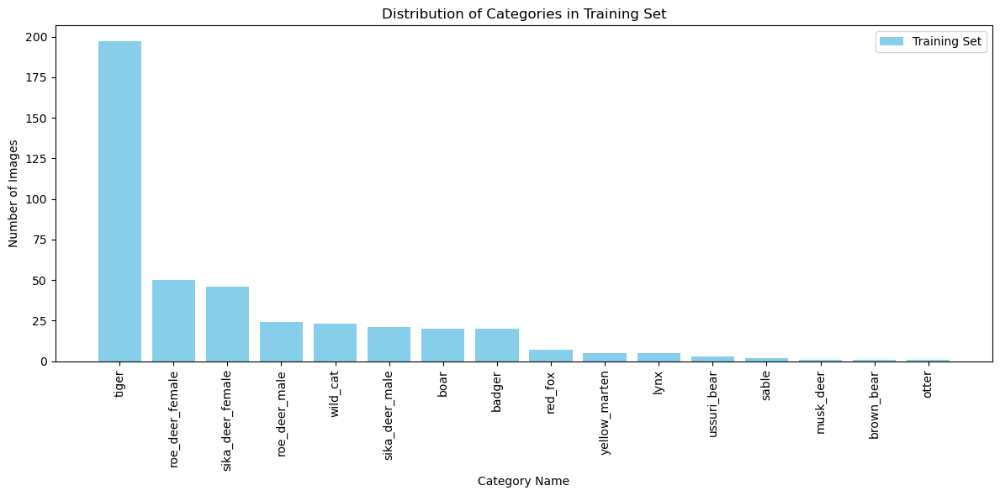

In [7]:
 
import matplotlib.pyplot as plt

# Plot the distribution of categories in the training set
plt.figure(figsize=(12, 6))
plt.bar(eda_df['Category_Name'], eda_df['Train_Count'], color='skyblue', label='Training Set')
plt.xticks(rotation=90)
plt.xlabel('Category Name')
plt.ylabel('Number of Images')
plt.title('Distribution of Categories in Training Set')
plt.legend()
plt.tight_layout()
plt.show()

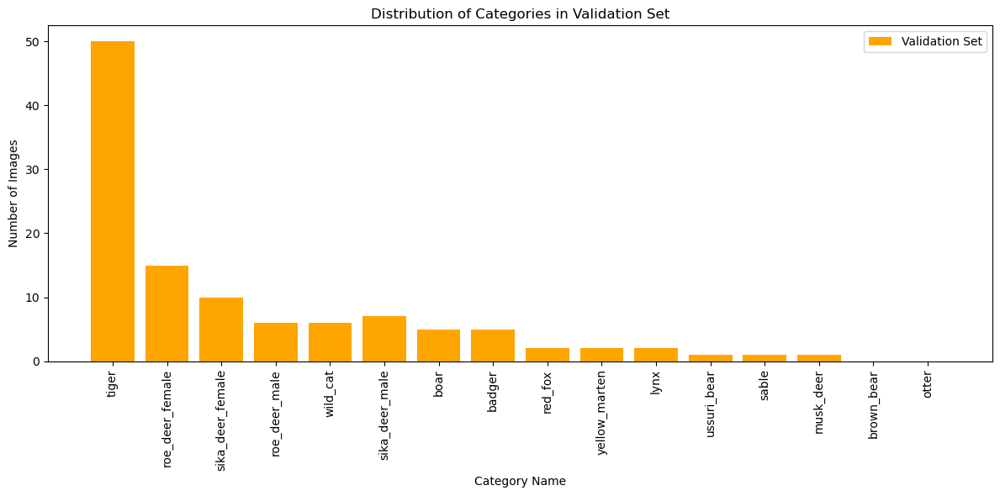

In [8]:
# Plot the distribution of categories in the validation set
plt.figure(figsize=(12, 6))
plt.bar(eda_df['Category_Name'], eda_df['Val_Count'], color='orange', label='Validation Set')
plt.xticks(rotation=90)
plt.xlabel('Category Name')
plt.ylabel('Number of Images')
plt.title('Distribution of Categories in Validation Set')
plt.legend()
plt.tight_layout()
plt.show()

### YOLO MODEL

##### Install Ultralytics and Define Dataset Path

In [3]:
!pip install ultralytics

  Using cached ultralytics-8.3.75-py3-none-any.whl.metadata (35 kB)
  Using cached opencv_python-4.11.0.86-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (20 kB)
  Using cached ultralytics_thop-2.0.14-py3-none-any.whl.metadata (9.4 kB)
Using cached ultralytics-8.3.75-py3-none-any.whl (914 kB)
Using cached opencv_python-4.11.0.86-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (63.0 MB)
Using cached ultralytics_thop-2.0.14-py3-none-any.whl (26 kB)

[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: pip install --upgrade pip


In [12]:
import os
from ultralytics import YOLO
import matplotlib.pyplot as plt
from PIL import Image

# Define dataset path
dataset_path = "/home/jovyan/__ANIMALS/datasets/ds1"

# Check if dataset exists
if os.path.exists(dataset_path):
    print(f"Dataset found at {dataset_path}")
    print("Training Images:", os.listdir(os.path.join(dataset_path, "train/images"))[:5])
    print("Validation Images:", os.listdir(os.path.join(dataset_path, "val/images/"))[:5])
else:
    print("Dataset not found. Please check the path.")

Dataset found at /home/jovyan/__ANIMALS/datasets/ds1
Training Images: ['Uss-1.1.AnikinRidge_003_12-21-2023_09-22.JPG', 'Uss-1.1.AnikinRidge_004_12-22-2023_15-40.JPG', 'Uss-1.1.AnikinRidge_005_12-22-2023_15-41.JPG', 'Uss-1.1.AnikinRidge_006_1-8-2024_19-13.JPG', 'Uss-1.1.AnikinRidge_009_1-20-2024_15-55.JPG']
Validation Images: ['Uss-1.1.AnikinRidge_002_12-17-2023_15-00.JPG', 'Uss-1.1.AnikinRidge_007_1-13-2024_13-12.JPG', 'Uss-1.1.AnikinRidge_008_1-20-2024_15-10.JPG', 'Uss-1.1.AnikinRidge_010_1-20-2024_15-59.JPG', 'Uss-1.AnikinRidge_008_1-20-2024_15-45.JPG']


Load Pretrained YOLO Model
Next, we'll load a pretrained YOLO model.

In [44]:
# Load a pretrained YOLO model
MODEL_NAME = "yolov8s.pt"  # Later, we will try yolov8s.pt, yolov8m.pt for better accuracy
model = YOLO(MODEL_NAME)

# Check if the model file exists
if os.path.exists(MODEL_NAME):
    print(f"Model {MODEL_NAME} loaded successfully.")
else:
    print(f"Model file {MODEL_NAME} not found. Please check the path.")

100%|██████████| 21.5M/21.5M [00:00<00:00, 42.6MB/s]

Model yolov8s.pt loaded successfully.


#### Train the Model Using the Animals Dataset
Now, we'll train the model using our newly created dataset

In [ ]:
# Train the model using the animals dataset
results = model.train(
    data="animals.yaml",
    epochs=70,
    batch=16,
    imgsz=640,
    lr0=0.001,  
    momentum=0.937,
    weight_decay=0.0005
)

Ultralytics 8.3.75 🚀 Python-3.12.7 torch-2.6.0+cu124 CPU (Intel Xeon Processor (Icelake))
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=animals.yaml, epochs=70, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True

train: Scanning /home/jovyan/__ANIMALS/datasets/ds1/train/labels.cache... 398 images, 0 backgrounds, 0 corrupt: 100%|██████████| 398/398 [00:00<?, ?it/s]
val: Scanning /home/jovyan/__ANIMALS/datasets/ds1/val/labels.cache... 105 images, 0 backgrounds, 0 corrupt: 100%|██████████| 105/105 [00:00<?, ?it/s]

Plotting labels to runs/detect/train3/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000417, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train3
Starting training for 70 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/70         0G      1.453      5.108      1.611         38        640: 100%|██████████| 25/25 [01:44<00:00,  4.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/4 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  25%|██▌       | 1/4 [00:09<00:28,  9.62s/it]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 2/4 [00:19<00:19,  9.65s/it]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:30<00:00,  7.60s/it]

                   all        105        113      0.289       0.17      0.109     0.0657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/70         0G      1.353      2.851      1.438         36        640: 100%|██████████| 25/25 [01:47<00:00,  4.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:14<00:00,  3.61s/it]

                   all        105        113      0.636      0.247      0.197      0.118



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/70         0G      1.232       2.11      1.359         22        640: 100%|██████████| 25/25 [01:45<00:00,  4.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.48s/it]

                   all        105        113      0.713      0.322      0.308      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/70         0G      1.245      1.922       1.38         34        640: 100%|██████████| 25/25 [01:46<00:00,  4.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.32s/it]

                   all        105        113      0.619      0.364      0.353      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/70         0G      1.226      1.672      1.384         33        640: 100%|██████████| 25/25 [01:48<00:00,  4.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.24s/it]

                   all        105        113      0.523      0.349      0.258      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/70         0G      1.169      1.568      1.316         28        640: 100%|██████████| 25/25 [01:47<00:00,  4.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.20s/it]

                   all        105        113      0.632      0.312      0.356      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/70         0G      1.155       1.43      1.298         34        640: 100%|██████████| 25/25 [01:47<00:00,  4.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.30s/it]

                   all        105        113      0.698      0.353      0.371      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/70         0G      1.193      1.374      1.317         25        640: 100%|██████████| 25/25 [01:45<00:00,  4.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:12<00:00,  3.23s/it]

                   all        105        113      0.537      0.333      0.367      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/70         0G      1.105      1.155      1.288         22        640: 100%|██████████| 25/25 [01:48<00:00,  4.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.35s/it]

                   all        105        113      0.408      0.449      0.428      0.242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/70         0G      1.113      1.216       1.28         31        640: 100%|██████████| 25/25 [01:48<00:00,  4.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.29s/it]

                   all        105        113      0.535      0.491      0.476       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/70         0G      1.043      1.073      1.252         35        640: 100%|██████████| 25/25 [01:48<00:00,  4.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.31s/it]

                   all        105        113      0.591      0.494      0.538       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/70         0G      1.071      1.064      1.254         25        640: 100%|██████████| 25/25 [01:45<00:00,  4.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.26s/it]

                   all        105        113      0.682      0.539      0.538      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/70         0G      1.052       1.05      1.226         31        640: 100%|██████████| 25/25 [01:48<00:00,  4.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.38s/it]

                   all        105        113      0.698      0.391      0.449      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/70         0G       1.03     0.9835      1.188         33        640: 100%|██████████| 25/25 [01:48<00:00,  4.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.31s/it]

                   all        105        113      0.633      0.443      0.449      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/70         0G     0.9944     0.9312      1.213         25        640: 100%|██████████| 25/25 [01:47<00:00,  4.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.30s/it]

                   all        105        113      0.543       0.56      0.539       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/70         0G      1.023     0.9352      1.228         29        640: 100%|██████████| 25/25 [01:46<00:00,  4.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.29s/it]

                   all        105        113      0.751      0.447       0.52       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/70         0G     0.9427     0.8574      1.174         34        640: 100%|██████████| 25/25 [01:47<00:00,  4.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:11<00:00,  2.82s/it]

                   all        105        113      0.599      0.539      0.502      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/70         0G      0.982     0.8558      1.183         28        640: 100%|██████████| 25/25 [01:45<00:00,  4.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.22s/it]

                   all        105        113      0.836      0.333      0.452      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/70         0G     0.8992     0.8373      1.136         36        640: 100%|██████████| 25/25 [01:48<00:00,  4.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.30s/it]

                   all        105        113      0.652       0.47       0.54      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/70         0G     0.8773     0.7816      1.146         24        640: 100%|██████████| 25/25 [01:47<00:00,  4.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.26s/it]

                   all        105        113      0.533      0.589      0.501      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/70         0G     0.9055     0.7585      1.148         27        640: 100%|██████████| 25/25 [01:48<00:00,  4.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.43s/it]

                   all        105        113      0.519      0.496      0.438       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/70         0G     0.8845     0.7472       1.14         29        640: 100%|██████████| 25/25 [01:48<00:00,  4.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.33s/it]

                   all        105        113       0.56      0.424      0.472      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/70         0G     0.8742     0.7147      1.136         22        640: 100%|██████████| 25/25 [01:49<00:00,  4.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.40s/it]

                   all        105        113      0.638       0.47      0.492      0.319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/70         0G     0.8329     0.6891      1.091         33        640: 100%|██████████| 25/25 [01:48<00:00,  4.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.34s/it]

                   all        105        113      0.568      0.531      0.514      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/70         0G     0.8603     0.7072      1.114         31        640: 100%|██████████| 25/25 [01:47<00:00,  4.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.14s/it]

                   all        105        113      0.754      0.377      0.467      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/70         0G      0.827     0.6907      1.111         27        640: 100%|██████████| 25/25 [01:44<00:00,  4.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:12<00:00,  3.02s/it]

                   all        105        113      0.546      0.531       0.56      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/70         0G     0.8527      0.709      1.137         21        640: 100%|██████████| 25/25 [01:47<00:00,  4.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.24s/it]

                   all        105        113      0.591      0.583      0.556      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/70         0G     0.7716     0.6492      1.063         31        640: 100%|██████████| 25/25 [01:47<00:00,  4.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.25s/it]

                   all        105        113      0.637      0.576      0.594      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/70         0G     0.8587     0.6565      1.121         28        640: 100%|██████████| 25/25 [01:46<00:00,  4.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.28s/it]

                   all        105        113      0.493      0.575      0.554      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/70         0G     0.7957     0.6457      1.104         31        640: 100%|██████████| 25/25 [01:45<00:00,  4.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.21s/it]

                   all        105        113      0.444      0.561      0.562      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/70         0G     0.8011     0.6778      1.111         36        640: 100%|██████████| 25/25 [01:46<00:00,  4.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:11<00:00,  2.90s/it]

                   all        105        113      0.589      0.566      0.535       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/70         0G     0.7798      0.605      1.088         31        640: 100%|██████████| 25/25 [01:44<00:00,  4.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.24s/it]

                   all        105        113      0.616      0.593        0.6      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/70         0G     0.7809     0.6357      1.102         27        640: 100%|██████████| 25/25 [01:45<00:00,  4.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.17s/it]

                   all        105        113      0.666      0.551      0.598      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/70         0G      0.793     0.6082      1.101         32        640: 100%|██████████| 25/25 [01:44<00:00,  4.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.22s/it]

                   all        105        113      0.583      0.603      0.567      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/70         0G     0.7911     0.6222      1.095         35        640: 100%|██████████| 25/25 [01:45<00:00,  4.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:10<00:00,  2.68s/it]

                   all        105        113      0.524      0.599      0.559      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/70         0G     0.7087     0.5374      1.046         35        640: 100%|██████████| 25/25 [01:47<00:00,  4.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:11<00:00,  2.89s/it]

                   all        105        113      0.629      0.518      0.583      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/70         0G     0.7449     0.5781       1.05         34        640: 100%|██████████| 25/25 [01:47<00:00,  4.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.30s/it]

                   all        105        113       0.75      0.511      0.618      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/70         0G     0.7179      0.531      1.036         41        640: 100%|██████████| 25/25 [01:47<00:00,  4.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.29s/it]

                   all        105        113      0.615      0.627       0.61       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/70         0G     0.6648      0.528       1.02         24        640: 100%|██████████| 25/25 [01:46<00:00,  4.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.23s/it]

                   all        105        113      0.777      0.494      0.561      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/70         0G     0.7011     0.5543      1.034         26        640: 100%|██████████| 25/25 [01:46<00:00,  4.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:13<00:00,  3.44s/it]

                   all        105        113      0.662      0.524      0.601      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/70         0G     0.6997     0.5386      1.031         35        640: 100%|██████████| 25/25 [01:47<00:00,  4.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.34s/it]

                   all        105        113      0.632      0.556      0.586       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/70         0G     0.6801     0.5219      1.024         24        640: 100%|██████████| 25/25 [01:47<00:00,  4.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.22s/it]

                   all        105        113      0.641      0.527        0.6      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/70         0G     0.6727      0.491      1.035         32        640: 100%|██████████| 25/25 [01:47<00:00,  4.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.32s/it]

                   all        105        113      0.493      0.647      0.596      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/70         0G     0.6649     0.4918      1.019         28        640: 100%|██████████| 25/25 [01:46<00:00,  4.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.32s/it]

#### Evaluate the Trained Model
After training, we can evaluate the model using a test image.

In [4]:
# Load the best model from the training run
import os
from ultralytics import YOLO
import matplotlib.pyplot as plt
from PIL import Image


model = YOLO("runs/detect/train3/weights/best.pt")

# Make predictions on a test image
rresults = model.predict("tiger_trial.jpg", save=True)

# Display the predicted image
%matplotlib inline
import os
import matplotlib.pyplot as plt
from PIL import Image


image 1/1 /home/jovyan/__ANIMALS/datasets/ds1/tiger_trial.jpg: 448x640 1 tiger, 194.7ms
Speed: 2.9ms preprocess, 194.7ms inference, 1.1ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict8


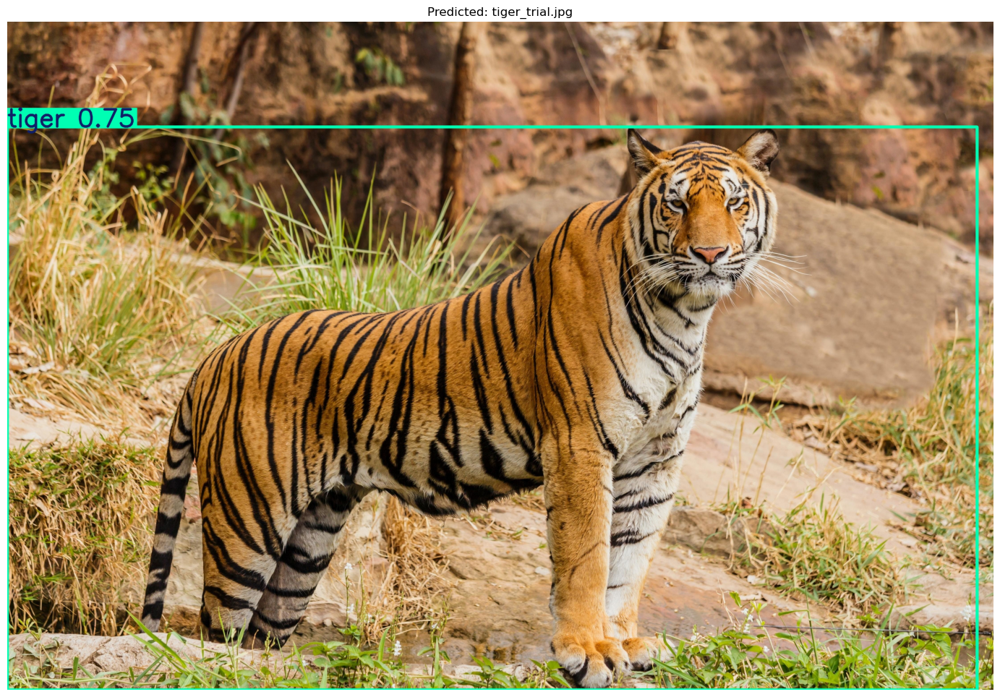

In [5]:
# Path to the predict folder
predict_dir = "runs/detect/predict8"

# List all files in the predict folder
predicted_files = [f for f in os.listdir(predict_dir) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

# Plot each predicted image
for file in predicted_files:
    pred_img_path = os.path.join(predict_dir, file)
    try:
        img = Image.open(pred_img_path)
        plt.figure(figsize=(18, 12))
        plt.imshow(img)
        plt.title(f"Predicted: {file}")
        plt.axis('off')
        plt.show()
    except Exception as e:
        print(f"Error loading {file}: {e}")

In [6]:
# Load the best model from the training run
model = YOLO("runs/detect/train3/weights/best.pt")

# Make predictions on a test image
results = model.predict("deer_1.jpg", save=True)

# Display the predicted image
%matplotlib inline
import os
import matplotlib.pyplot as plt
from PIL import Image


image 1/1 /home/jovyan/__ANIMALS/datasets/ds1/deer_1.jpg: 576x640 1 roe_deer_female, 272.0ms
Speed: 3.1ms preprocess, 272.0ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)
Results saved to runs/detect/predict9


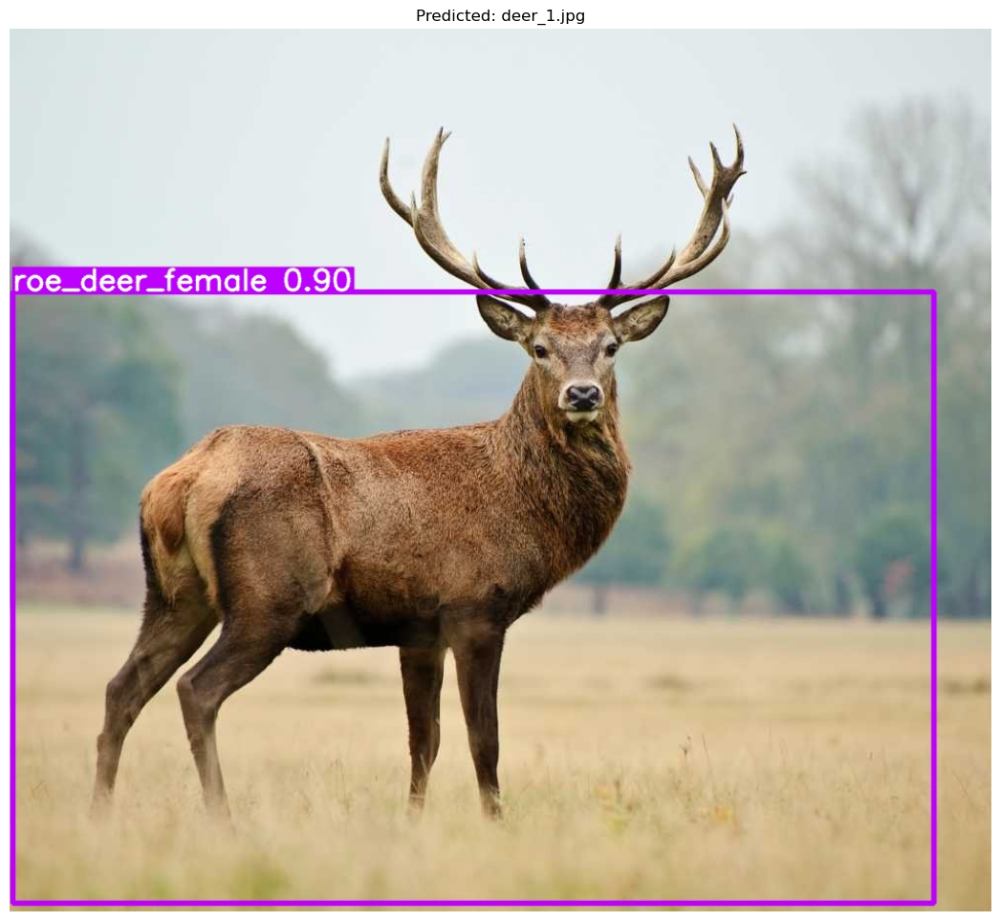

In [7]:
# Path to the predict folder
predict_dir = "runs/detect/predict9"

# List all files in the predict folder
predicted_files = [f for f in os.listdir(predict_dir) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

# Plot each predicted image
for file in predicted_files:
    pred_img_path = os.path.join(predict_dir, file)
    try:
        img = Image.open(pred_img_path)
        plt.figure(figsize=(18, 12))
        plt.imshow(img)
        plt.title(f"Predicted: {file}")
        plt.axis('off')
        plt.show()
    except Exception as e:
        print(f"Error loading {file}: {e}")

#### Plot Training Metrics
Finally, let's plot the training metrics to evaluate the model's performance.

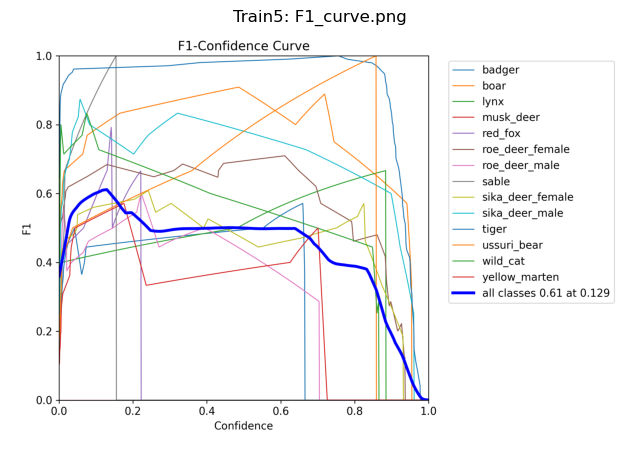

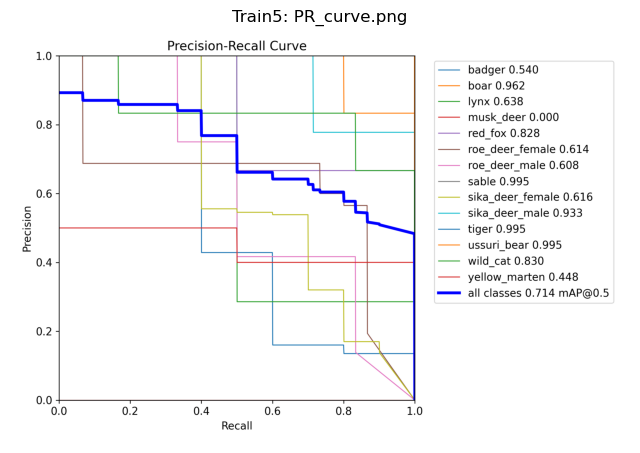

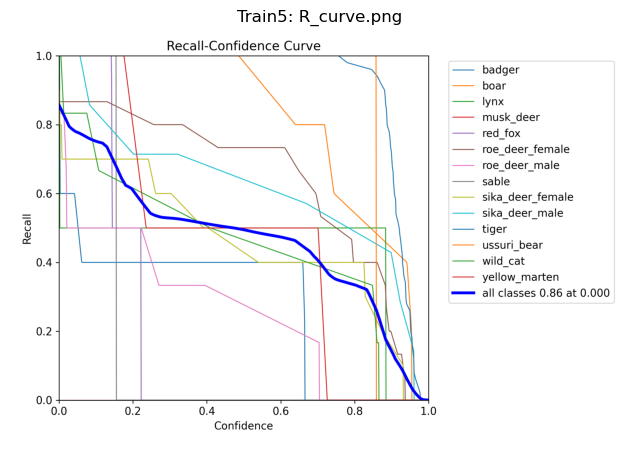

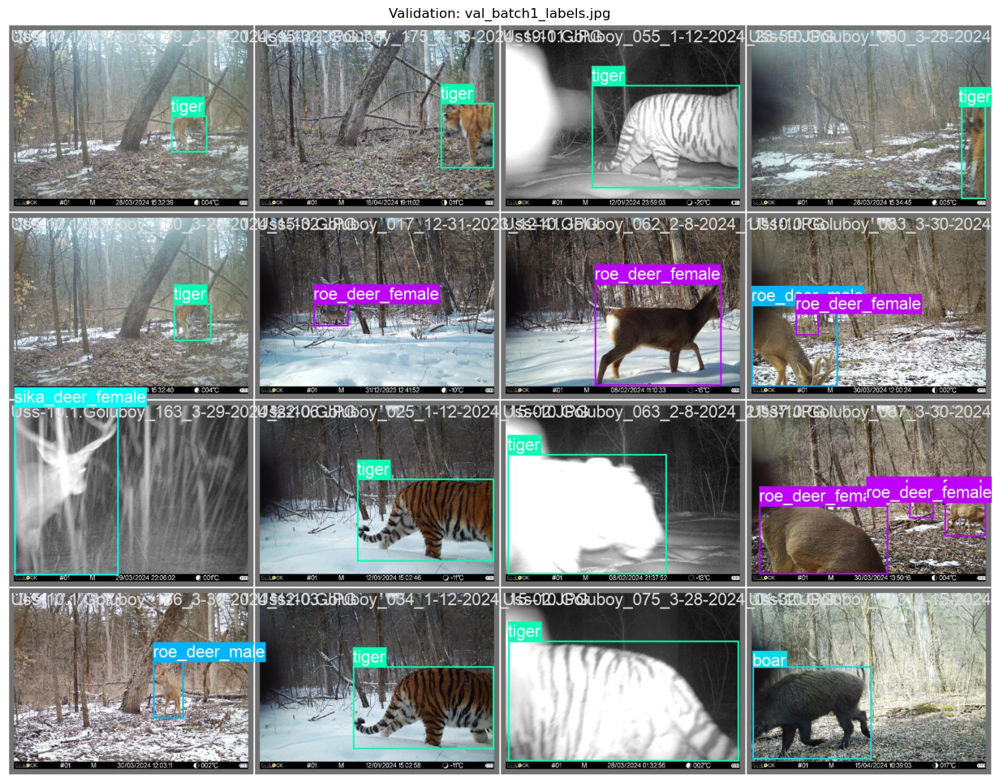

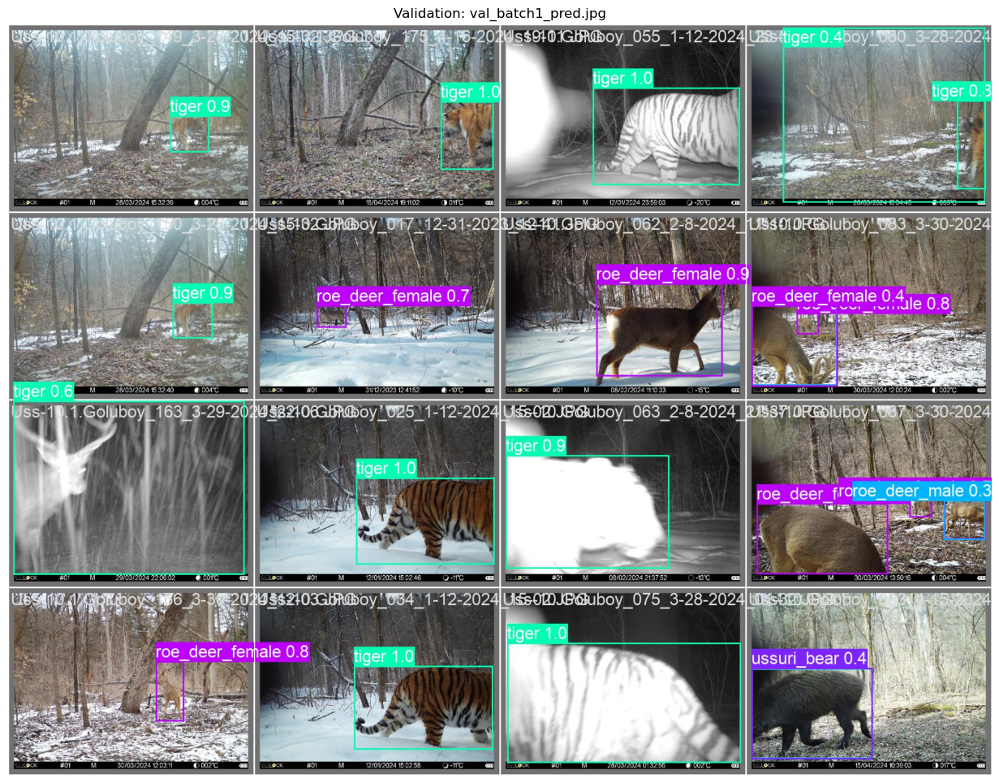

In [8]:
# Path to the train folder
train5_dir = "runs/detect/train3"

# List of metrics to plot
metrics = ["F1_curve.png", "PR_curve.png", "R_curve.png"]

# Plot each metric
for metric in metrics:
    metric_path = os.path.join(train5_dir, metric)
    if os.path.exists(metric_path):
        img = Image.open(metric_path)
        plt.figure(figsize=(8, 6))
        plt.imshow(img)
        plt.title(f"Train5: {metric}")
        plt.axis('off')
        plt.show()
    else:
        print(f"Warning: {metric} not found in {train5_dir}.")


# Path to the val folder
val_dir = "runs/detect/train3"

# List of metrics to plot
metrics = ["val_batch1_labels.jpg", "val_batch1_pred.jpg"]

# Plot each metric
for metric in metrics:
    metric_path = os.path.join(val_dir, metric)
    if os.path.exists(metric_path):
        img = Image.open(metric_path)
        plt.figure(figsize=(18, 12))
        plt.imshow(img)
        plt.title(f"Validation: {metric}")
        plt.axis('off')
        plt.show()
    else:
        print(f"Warning: {metric} not found in {val_dir}.")

#### Making predictions

In [14]:
import os
import random

# Directory containing images
images_dir = "/home/jovyan/__ANIMALS/images"

# Select 3 random images
image_files = [f for f in os.listdir(images_dir) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]
random_images = random.sample(image_files, min(3, len(image_files)))

# Print selected images
print("Selected images for prediction:")
for img in random_images:
    print(img)

Selected images for prediction:
Uss-18.1.SuvorovskyCreek_138_4-12-2024_10-06.JPG
Uss-25.1.PravayaKomarovka_372_2-8-2024_10-54.JPG
Uss-62.Komarovka_491_4-8-2024_23-26.JPG


In [15]:
from ultralytics import YOLO

# Load the trained YOLO model
model = YOLO("runs/detect/train3/weights/best.pt")

In [16]:
# Make predictions and save results
for img in random_images:
    img_path = os.path.join(images_dir, img)
    results = model.predict(img_path, save=True, save_dir="runs/detect/predict")
    print(f"Prediction saved for {img} in runs/detect/predict.")


image 1/1 /home/jovyan/__ANIMALS/images/Uss-18.1.SuvorovskyCreek_138_4-12-2024_10-06.JPG: 480x640 1 badger, 173.3ms
Speed: 2.9ms preprocess, 173.3ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict11
Prediction saved for Uss-18.1.SuvorovskyCreek_138_4-12-2024_10-06.JPG in runs/detect/predict.

image 1/1 /home/jovyan/__ANIMALS/images/Uss-25.1.PravayaKomarovka_372_2-8-2024_10-54.JPG: 480x640 1 roe_deer_female, 210.1ms
Speed: 2.8ms preprocess, 210.1ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict11
Prediction saved for Uss-25.1.PravayaKomarovka_372_2-8-2024_10-54.JPG in runs/detect/predict.

image 1/1 /home/jovyan/__ANIMALS/images/Uss-62.Komarovka_491_4-8-2024_23-26.JPG: 480x640 1 badger, 1 red_fox, 209.6ms
Speed: 2.9ms preprocess, 209.6ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict11
Prediction saved for Uss-62.Komarovka_4

In [12]:
import os

# Path to the predict folder
predict_dir = "runs/detect/predict10"

# List all files in the predict folder
predicted_files = os.listdir(predict_dir)
print("Predicted files in runs/detect/predict:")
for file in predicted_files:
    print(file)

Predicted files in runs/detect/predict:
Uss-25.1.PravayaKomarovka_260_1-27-2024_01-44.jpg
Uss-7.1.BolshayaIvnyachka_101_3-28-2024_00-25.jpg
Uss-8.Komarovka,border_206_1-29-2024_08-42.jpg


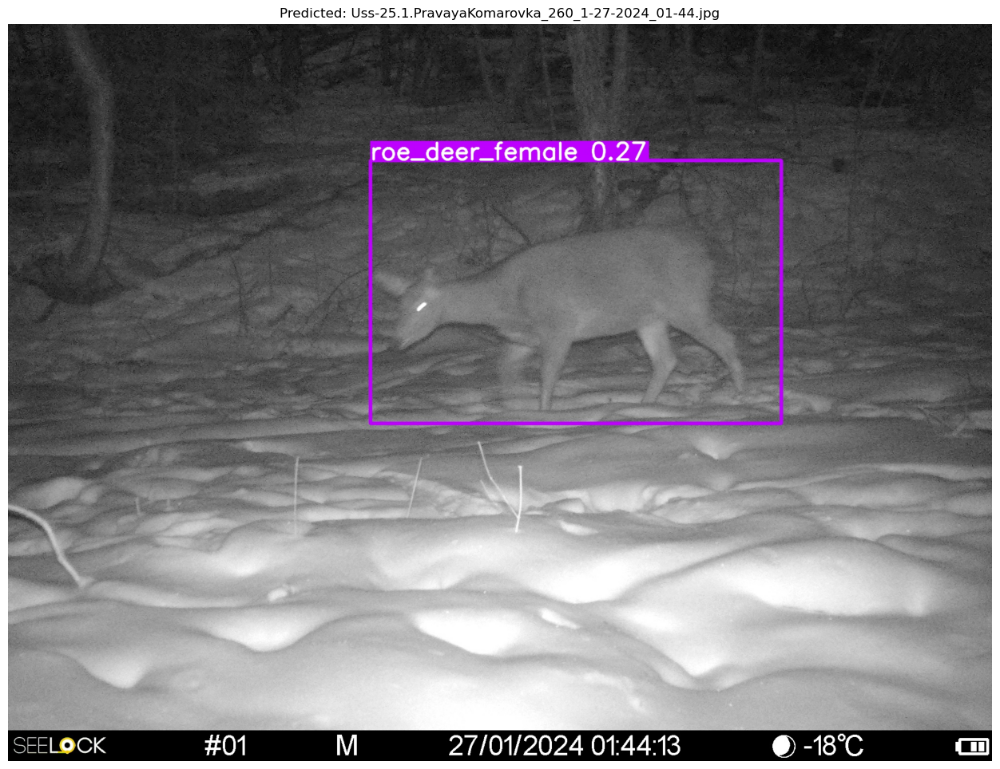

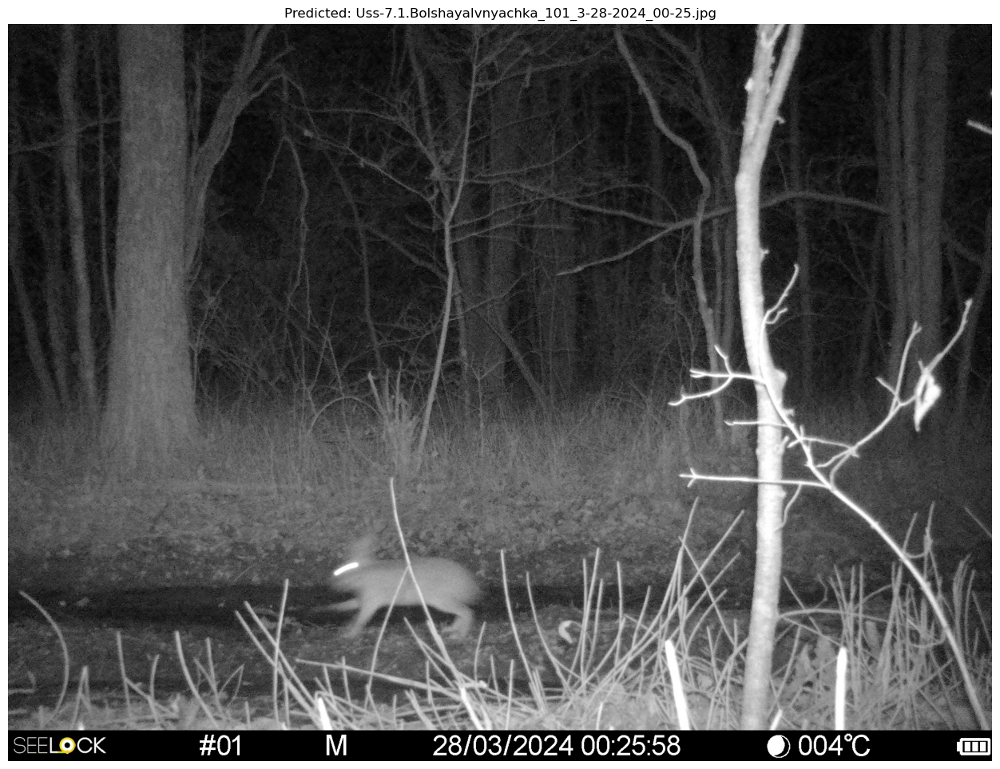

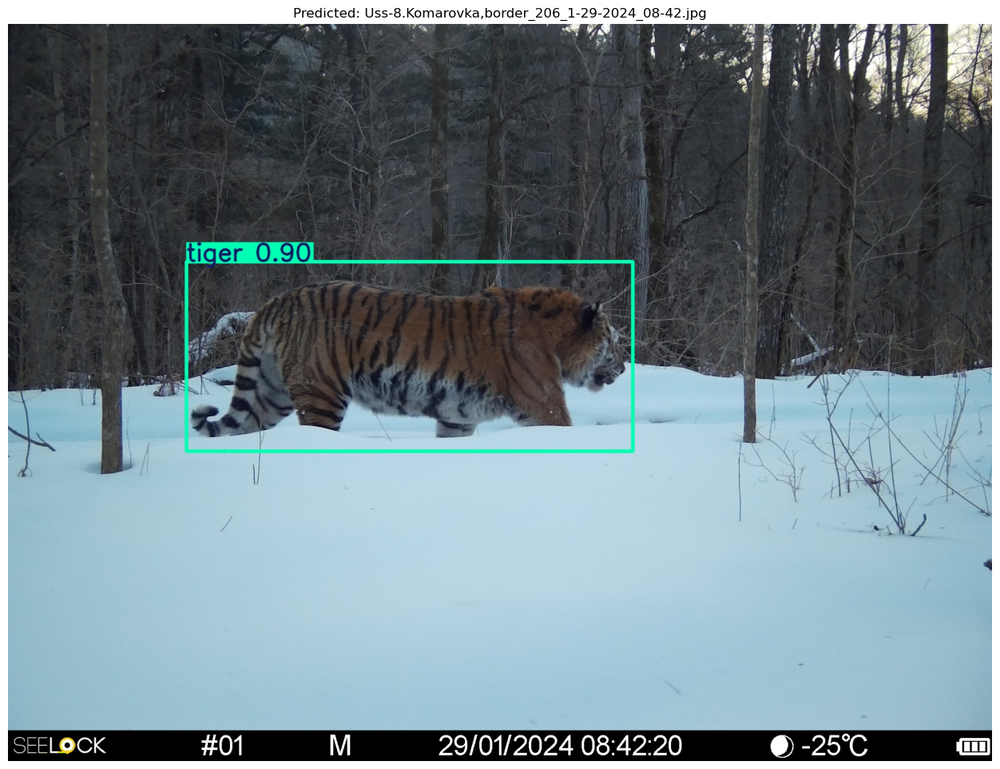

In [13]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# Path to the predict folder
predict_dir = "runs/detect/predict10"

# List all files in the predict folder
predicted_files = [f for f in os.listdir(predict_dir) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

# Plot each predicted image
for file in predicted_files:
    pred_img_path = os.path.join(predict_dir, file)
    try:
        img = Image.open(pred_img_path)
        plt.figure(figsize=(18, 12))
        plt.imshow(img)
        plt.title(f"Predicted: {file}")
        plt.axis('off')
        plt.show()
    except Exception as e:
        print(f"Error loading {file}: {e}")

In [17]:
import os

# Path to the predict folder
predict_dir = "runs/detect/predict11"

# List all files in the predict folder
predicted_files = os.listdir(predict_dir)
print("Predicted files in runs/detect/predict:")
for file in predicted_files:
    print(file)

Predicted files in runs/detect/predict:
Uss-18.1.SuvorovskyCreek_138_4-12-2024_10-06.jpg
Uss-25.1.PravayaKomarovka_372_2-8-2024_10-54.jpg
Uss-62.Komarovka_491_4-8-2024_23-26.jpg


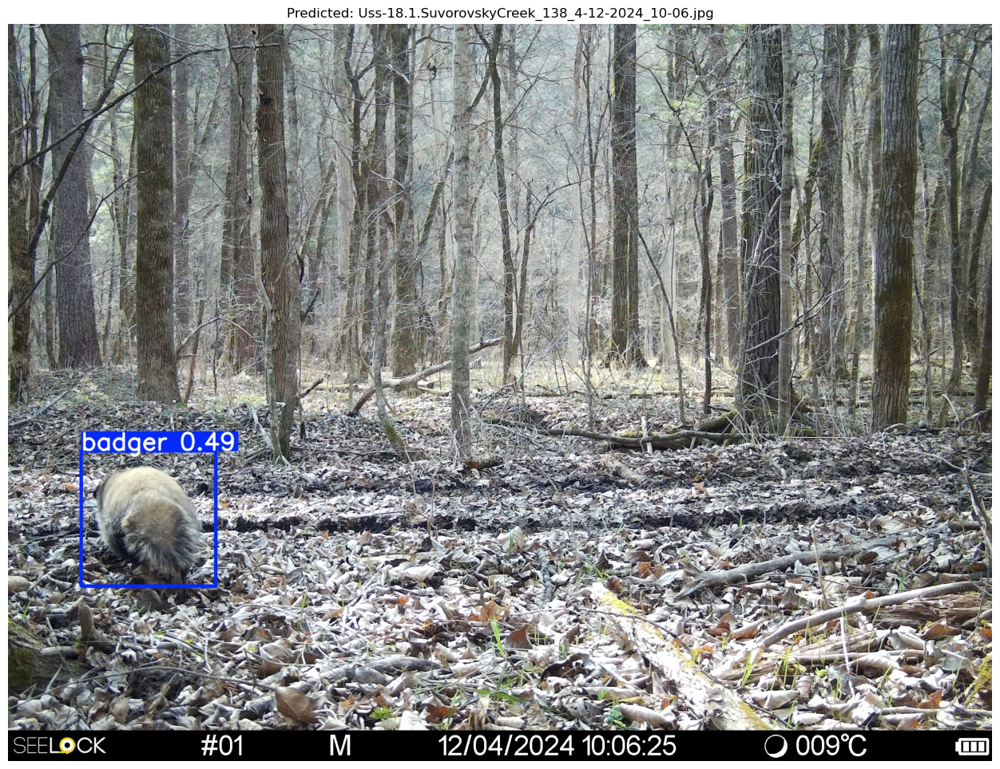

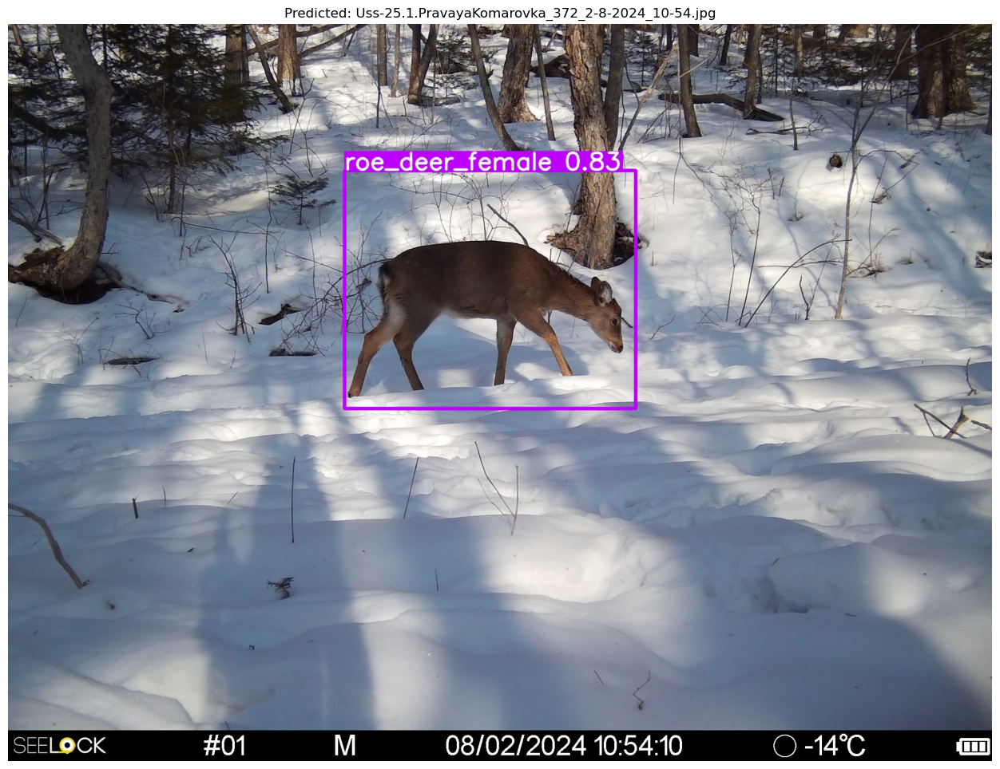

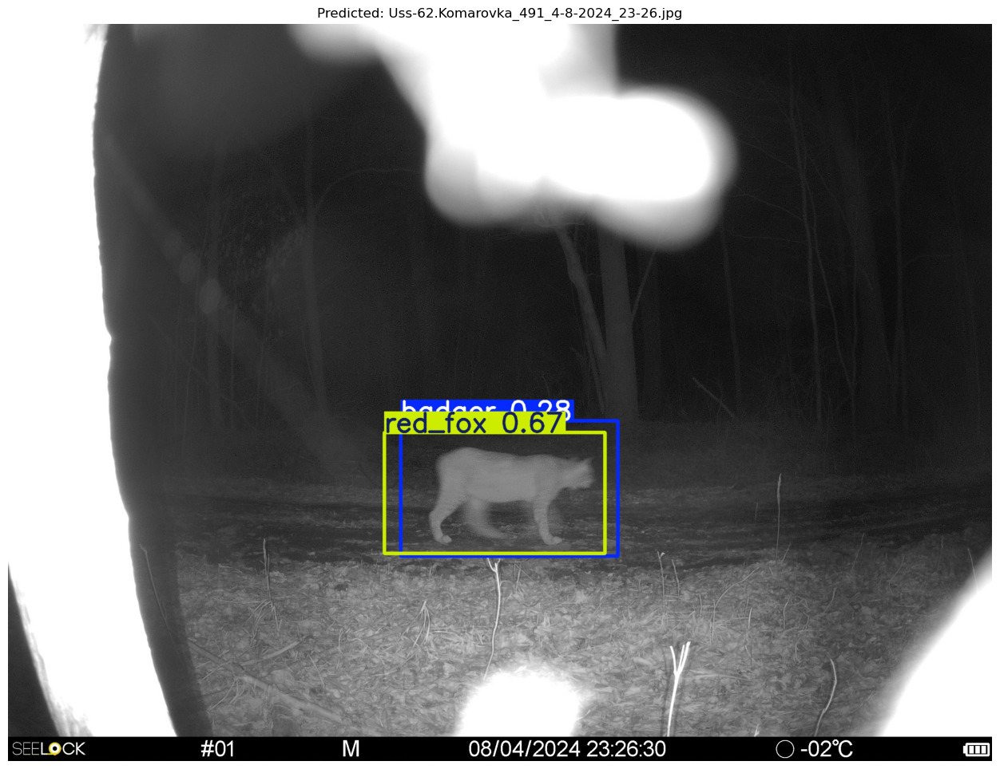

In [18]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# Path to the predict folder
predict_dir = "runs/detect/predict11"

# List all files in the predict folder
predicted_files = [f for f in os.listdir(predict_dir) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

# Plot each predicted image
for file in predicted_files:
    pred_img_path = os.path.join(predict_dir, file)
    try:
        img = Image.open(pred_img_path)
        plt.figure(figsize=(18, 12))
        plt.imshow(img)
        plt.title(f"Predicted: {file}")
        plt.axis('off')
        plt.show()
    except Exception as e:
        print(f"Error loading {file}: {e}")